#### A 2D strip simulation designed to test the Out-of-Africa model under different migration patterns

In [1]:
include("../resk.jl")
include("../reskplots.jl")

RESK successfully loaded.
RESKPlots successfully loaded.


In [2]:
function av_by_dist(obj,gen)
    return [mean(obj[x,:,gen,:]) for x in 1:size(obj)[1]]
end

function myfit(x, y)
    n = length(x)
    x_mean = mean(x)
    y_mean = mean(y)
    slope = sum((x .- x_mean) .* (y .- y_mean)) / sum((x .- x_mean) .^ 2)
    intercept = y_mean - slope * x_mean
    return slope, intercept
end

analyse(re) = av_by_dist((re["Aasel"]+re["Aaneu"])/1000,re["stats"]["n_gens"])

analyse2(re) = average_ts(average_front((re["Aasel"]+re["Aaneu"])/1000,re["stats"]["n_gens"],re["stats"]["max"]...;oneside=true), re["stats"]["n_gens"])

function Rtwo(y,y_pred)
    ss_total = sum((y .- mean(y)).^2)
    ss_residual = sum((y .- y_pred).^2)
    r2 = 1 - (ss_residual / ss_total)
end

function comp_dict(dict1,dict2)
    common_keys = intersect(keys(dict1["stats"]), keys(dict2["stats"]))
    different_values = filter(k -> dict1["stats"][k] != dict2["stats"][k], common_keys)
    for v in different_values
        println(v*": "*string(dict1["stats"][v])*" <-> "*string(dict2["stats"][v]))
    end
end

comp_dict (generic function with 1 method)

In [3]:
re_ort = deserialize("data/ooa_move.re")
re_half = deserialize("data/ooa_move2.re")
re_all = deserialize("data/ooa_move3.re")

Dict{String, Any} with 9 entries:
  "AAsel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "pops"  => Float32[]
  "aasel" => Float32[312.0 312.0 … 312.0 312.0; 312.0 312.0 … 312.0 312.0; … ; …
  "fitn"  => Float32[]
  "aaneu" => Float32[688.0 688.0 … 688.0 688.0; 688.0 688.0 … 688.0 688.0; … ; …
  "Aasel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "Aaneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "AAneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "stats" => Dict{String, Any}("n_sel_loci"=>312, "sel_loci"=>[739, 852, 97, 55…

In [4]:
re_ort["stats"]

Dict{String, Any} with 21 entries:
  "n_sel_loci"        => 312
  "sel_loci"          => [684, 663, 400, 115, 369, 755, 125, 145, 749, 682  …  …
  "max"               => (500, 5)
  "wlddim"            => 2
  "prolif_rate"       => 1.8
  "sel_coef"          => 0.01
  "max_burnin"        => (5, 5)
  "name"              => "2024-08-17_17-47-00"
  "startfill"         => UnitRange{Int64}[1:5, 1:5]
  "n_gens"            => 2500
  "domin_coef"        => 0
  "migr_mode"         => "ort"
  "n_gens_exp"        => 2000
  "n_gens_burnin"     => 500
  "mut_rate"          => 1
  "n_loci"            => 1000
  "max_exp"           => (500, 5)
  "n_demes_startfill" => 5
  "prop_of_del_muts"  => 0.9
  ⋮                   => ⋮

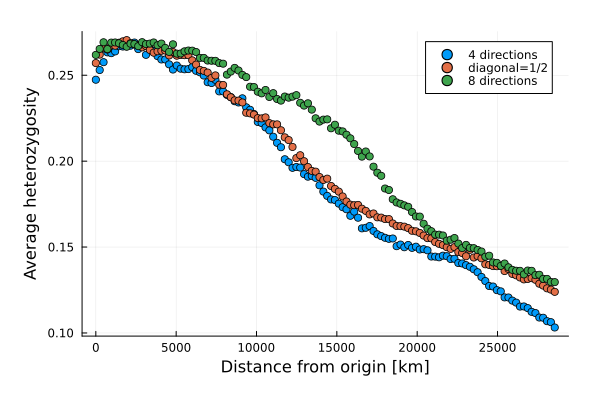

In [4]:

av_ort = analyse(re_ort)
av_half = analyse(re_half)
av_all = analyse(re_all)
Plots.scatter(1:240:(240*120),av_ort,label="4 directions",xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain)
Plots.scatter!(1:240:(240*120),av_half,label="diagonal=1/2")
Plots.scatter!(1:240:(240*120),av_all,label="8 directions")

In [6]:
slope, intercept = myfit(collect(1:120).*240, av_ort[1:120])
slope2, intercept2 = myfit(collect(1:120).*240, av_half[1:120])
slope3, intercept3 = myfit(collect(1:120).*240, av_all[1:120])

Rtwo_ort = Rtwo(av_ort[1:120],slope.*collect(1:240:(240*120)).+intercept)
Rtwo_half = Rtwo(av_half[1:120],slope2.*collect(1:240:(240*120)).+intercept2)
Rtwo_all = Rtwo(av_all[1:120],slope3.*collect(1:240:(240*120)).+intercept3)

0.9557385310555363

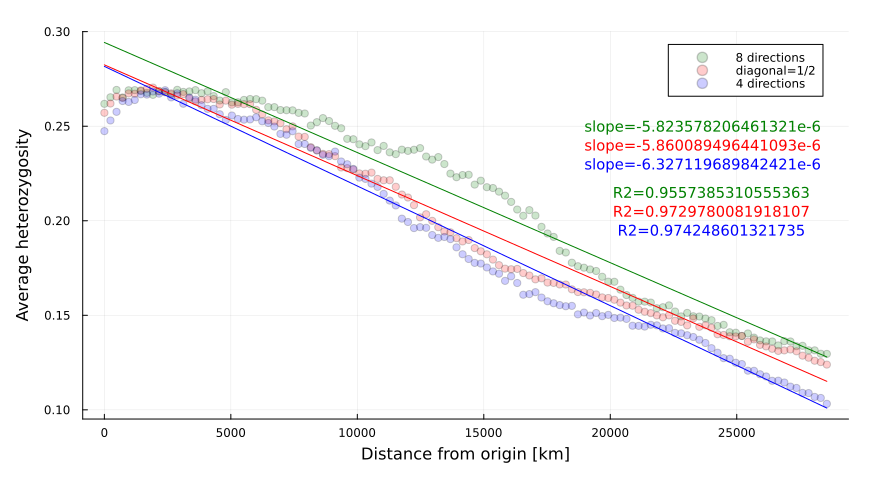

In [7]:
Plots.scatter(1:240:(240*120),av_all,label="8 directions",color=:green,opacity=0.2)
Plots.scatter!(1:240:(240*120),av_half,label="diagonal=1/2",color=:red,opacity=0.2)
Plots.scatter!(1:240:(240*120),av_ort,label="4 directions",color=:blue,opacity=0.2,xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain,size=(880, 480))

Plots.plot!(1:240:(240*120),slope.*collect(1:240:(240*120)).+intercept,color=:blue,label=:none)
Plots.plot!(1:240:(240*120),slope2.*collect(1:240:(240*120)).+intercept2,color=:red,label=:none)
Plots.plot!(1:240:(240*120),slope3.*collect(1:240:(240*120)).+intercept3,color=:green,label=:none)

Plots.annotate!(23650, 0.25, ("slope=$slope3", 10, :green))
Plots.annotate!(23650, 0.24, ("slope=$slope2", 10, :red))
Plots.annotate!(23650, 0.23, ("slope=$slope", 10, :blue))

Plots.annotate!(24000, 0.215, ("R2=$Rtwo_all", 10, :green))
Plots.annotate!(24000, 0.205, ("R2=$Rtwo_half", 10, :red))
Plots.annotate!(24000, 0.195, ("R2=$Rtwo_ort", 10, :blue))

In [8]:
slope, intercept = myfit(collect(1:120), av_ort[1:120])
slope2, intercept2 = myfit(collect(1:120), av_half[1:120])
slope3, intercept3 = myfit(collect(1:120), av_all[1:120])

Rtwo_ort = Rtwo(av_ort[1:120],slope.*collect(1:120).+intercept)
Rtwo_half = Rtwo(av_half[1:120],slope2.*collect(1:120).+intercept2)
Rtwo_all = Rtwo(av_all[1:120],slope3.*collect(1:120).+intercept3)

0.9565291101233386

---

In [2]:
re_1 = deserialize("data/ooa_moveA.re")
re_2 = deserialize("data/ooa_moveB.re")
re_3 = deserialize("data/ooa_moveC.re")
re_4 = deserialize("data/ooa_moveD.re")

Dict{String, Any} with 9 entries:
  "AAsel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "pops"  => Float32[]
  "aasel" => Float32[312.0 312.0 … 312.0 312.0; 312.0 312.0 … 312.0 312.0; … ; …
  "fitn"  => Float32[]
  "aaneu" => Float32[688.0 688.0 … 688.0 688.0; 688.0 688.0 … 688.0 688.0; … ; …
  "Aasel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "Aaneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "AAneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "stats" => Dict{String, Any}("n_sel_loci"=>312, "sel_loci"=>[103, 749, 649, 6…

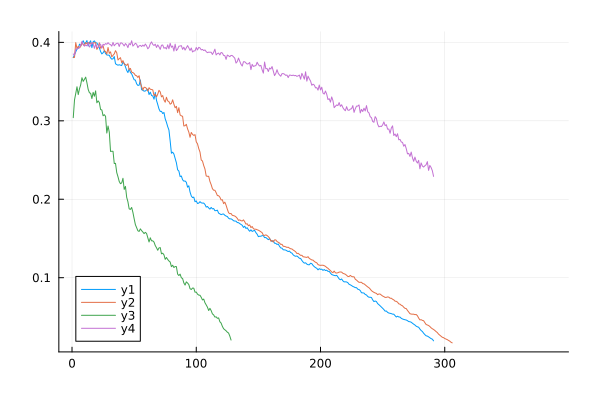

In [41]:
av_1 = analyse(re_1)
av_2 = analyse(re_2)
av_3 = analyse(re_3)
av_4 = analyse(re_4)
Plots.plot(analyse(re_1))
Plots.plot!(analyse(re_2))
Plots.plot!(analyse(re_3))
Plots.plot!(analyse(re_4))

In [46]:
slope1, intercept1 = myfit(collect(1:282).*24, av_1[1:282])
slope2, intercept2 = myfit(collect(1:282).*24, av_2[1:282])
slope4, intercept4 = myfit(collect(1:282).*24, av_4[1:282])

(-2.0436010245035545e-5, 0.4269974458199117)

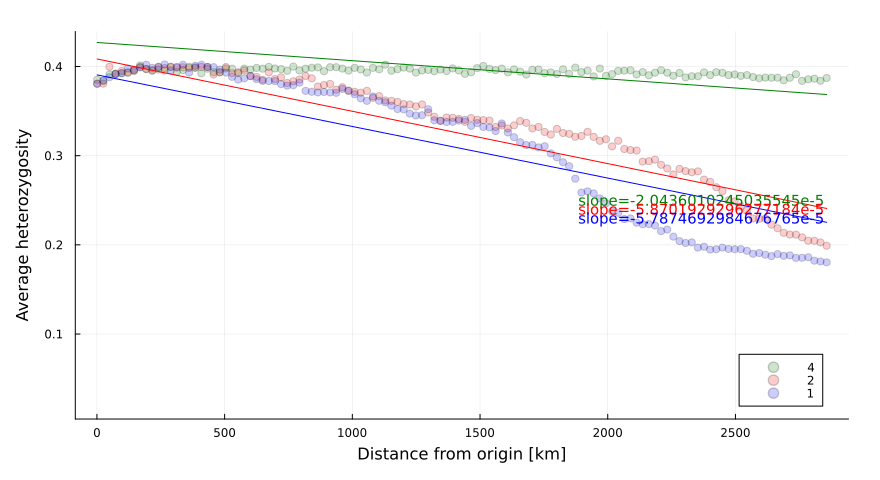

In [49]:
Plots.scatter(1:24:(24*120),av_4,label="4",color=:green,opacity=0.2)
Plots.scatter!(1:24:(24*120),av_2,label="2",color=:red,opacity=0.2)
Plots.scatter!(1:24:(24*120),av_1,label="1",color=:blue,opacity=0.2,xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain,size=(880, 480))

Plots.plot!(1:24:(24*120),slope1.*collect(1:24:(24*120)).+intercept1,color=:blue,label=:none)
Plots.plot!(1:24:(24*120),slope2.*collect(1:24:(24*120)).+intercept2,color=:red,label=:none)
Plots.plot!(1:24:(24*120),slope4.*collect(1:24:(24*120)).+intercept4,color=:green,label=:none)

Plots.annotate!(2365, 0.25, ("slope=$slope4", 10, :green))
Plots.annotate!(2365, 0.24, ("slope=$slope2", 10, :red))
Plots.annotate!(2365, 0.23, ("slope=$slope1", 10, :blue))

# -2*10^(-5)/6*10^(-6) ~ 3 => try 24*3 km for deme distance

┌ Info: Saved animation to C:\Users\Hartree\AppData\Local\Temp\jl_BofAVoH6bC.gif
└ @ Plots C:\Users\Hartree\.julia\packages\Plots\ju9dp\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\Hartree\\AppData\\Local\\Temp\\jl_BofAVoH6bC.gif")
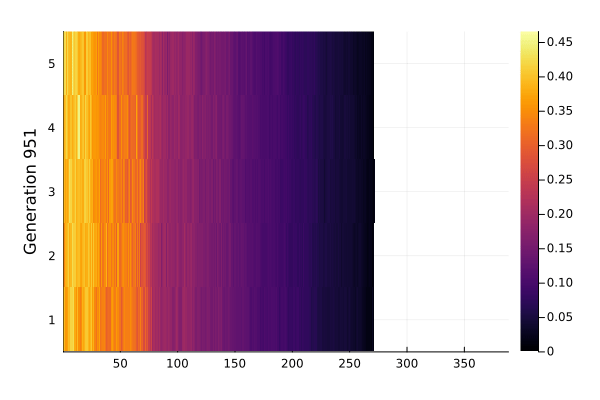

In [52]:
re_heatmap(re_1["Aasel"][:,:,:,1]/312,950,1000)

In [6]:
comp_dict(re_1,re_2)

name: 2024-08-17_01-18-09  2024-08-17_01-18-12
sel_loci: [581, 103, 714, 625, 156, 88, 532, 91, 267, 485, 752, 629, 865, 542, 572, 594, 432, 425, 924, 656, 136, 144, 385, 489, 333, 28, 988, 849, 60, 111, 712, 368, 786, 859, 304, 17, 14, 818, 781, 630, 788, 501, 124, 442, 758, 474, 187, 41, 364, 831, 607, 213, 470, 357, 764, 298, 957, 80, 651, 531, 837, 438, 149, 435, 823, 947, 553, 169, 119, 976, 524, 760, 454, 194, 463, 820, 716, 774, 574, 87, 480, 728, 937, 968, 798, 540, 491, 691, 666, 462, 495, 669, 608, 355, 792, 282, 417, 952, 771, 74, 768, 142, 817, 638, 148, 389, 184, 327, 13, 449, 232, 696, 388, 294, 844, 188, 720, 654, 902, 494, 793, 259, 153, 782, 784, 135, 164, 923, 48, 69, 145, 93, 193, 458, 241, 20, 440, 932, 329, 133, 757, 605, 374, 312, 939, 138, 514, 713, 956, 687, 801, 870, 631, 211, 210, 47, 452, 498, 4, 613, 772, 461, 972, 925, 43, 92, 158, 878, 299, 110, 55, 455, 488, 316, 799, 732, 966, 744, 129, 297, 819, 775, 519, 33, 433, 959, 439, 981, 290, 545, 856, 126, 735,

In [7]:
comp_dict(re_1,re_3)

name: 2024-08-17_01-18-09  2024-08-17_01-18-16
sel_loci: [581, 103, 714, 625, 156, 88, 532, 91, 267, 485, 752, 629, 865, 542, 572, 594, 432, 425, 924, 656, 136, 144, 385, 489, 333, 28, 988, 849, 60, 111, 712, 368, 786, 859, 304, 17, 14, 818, 781, 630, 788, 501, 124, 442, 758, 474, 187, 41, 364, 831, 607, 213, 470, 357, 764, 298, 957, 80, 651, 531, 837, 438, 149, 435, 823, 947, 553, 169, 119, 976, 524, 760, 454, 194, 463, 820, 716, 774, 574, 87, 480, 728, 937, 968, 798, 540, 491, 691, 666, 462, 495, 669, 608, 355, 792, 282, 417, 952, 771, 74, 768, 142, 817, 638, 148, 389, 184, 327, 13, 449, 232, 696, 388, 294, 844, 188, 720, 654, 902, 494, 793, 259, 153, 782, 784, 135, 164, 923, 48, 69, 145, 93, 193, 458, 241, 20, 440, 932, 329, 133, 757, 605, 374, 312, 939, 138, 514, 713, 956, 687, 801, 870, 631, 211, 210, 47, 452, 498, 4, 613, 772, 461, 972, 925, 43, 92, 158, 878, 299, 110, 55, 455, 488, 316, 799, 732, 966, 744, 129, 297, 819, 775, 519, 33, 433, 959, 439, 981, 290, 545, 856, 126, 735,

In [8]:
comp_dict(re_1,re_4)

name: 2024-08-17_01-18-09  2024-08-17_01-18-30
sel_loci: [581, 103, 714, 625, 156, 88, 532, 91, 267, 485, 752, 629, 865, 542, 572, 594, 432, 425, 924, 656, 136, 144, 385, 489, 333, 28, 988, 849, 60, 111, 712, 368, 786, 859, 304, 17, 14, 818, 781, 630, 788, 501, 124, 442, 758, 474, 187, 41, 364, 831, 607, 213, 470, 357, 764, 298, 957, 80, 651, 531, 837, 438, 149, 435, 823, 947, 553, 169, 119, 976, 524, 760, 454, 194, 463, 820, 716, 774, 574, 87, 480, 728, 937, 968, 798, 540, 491, 691, 666, 462, 495, 669, 608, 355, 792, 282, 417, 952, 771, 74, 768, 142, 817, 638, 148, 389, 184, 327, 13, 449, 232, 696, 388, 294, 844, 188, 720, 654, 902, 494, 793, 259, 153, 782, 784, 135, 164, 923, 48, 69, 145, 93, 193, 458, 241, 20, 440, 932, 329, 133, 757, 605, 374, 312, 939, 138, 514, 713, 956, 687, 801, 870, 631, 211, 210, 47, 452, 498, 4, 613, 772, 461, 972, 925, 43, 92, 158, 878, 299, 110, 55, 455, 488, 316, 799, 732, 966, 744, 129, 297, 819, 775, 519, 33, 433, 959, 439, 981, 290, 545, 856, 126, 735,

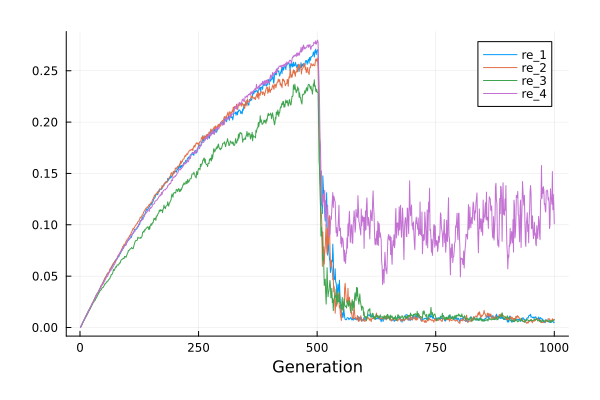

In [38]:
frontav_1 = analyse2(re_1)
Plots.plot(frontav_1,label="re_1",xlabel="Generation")
frontav_2 = analyse2(re_2)
Plots.plot!(frontav_2,label="re_2",xlabel="Generation")
frontav_3 = analyse2(re_3)
Plots.plot!(frontav_3,label="re_3",xlabel="Generation")
frontav_4 = analyse2(re_4)
Plots.plot!(frontav_4,label="re_4",xlabel="Generation")

---

In [3]:
re = deserialize("data/ooa_375.re")

Dict{String, Any} with 9 entries:
  "AAsel" => Float32[0.0 NaN … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "pops"  => Float32[]
  "aasel" => Float32[312.0 NaN … 312.0 312.0; 312.0 312.0 … 312.0 312.0; … ; Na…
  "fitn"  => Float32[]
  "aaneu" => Float32[688.0 NaN … 688.0 688.0; 688.0 688.0 … 688.0 688.0; … ; Na…
  "Aasel" => Float32[0.0 NaN … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "Aaneu" => Float32[0.0 NaN … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "AAneu" => Float32[0.0 NaN … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "stats" => Dict{String, Any}("n_sel_loci"=>312, "sel_loci"=>[831, 332, 220, 3…

┌ Info: Saved animation to C:\Users\Hartree\AppData\Local\Temp\jl_ryXa5wtc1K.gif
└ @ Plots C:\Users\Hartree\.julia\packages\Plots\ju9dp\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\Hartree\\AppData\\Local\\Temp\\jl_ryXa5wtc1K.gif")
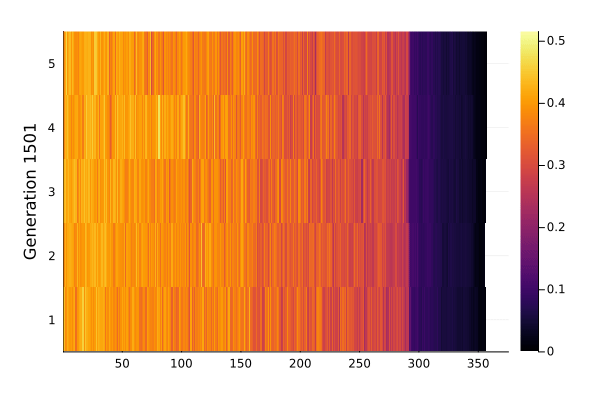

In [26]:
re_heatmap(repl(re["Aasel"],1)/312,re["stats"]["n_gens"]-1000,re["stats"]["n_gens"]-950)

┌ Info: Saved animation to C:\Users\Hartree\AppData\Local\Temp\jl_L636xCLMPU.gif
└ @ Plots C:\Users\Hartree\.julia\packages\Plots\ju9dp\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\Hartree\\AppData\\Local\\Temp\\jl_L636xCLMPU.gif")
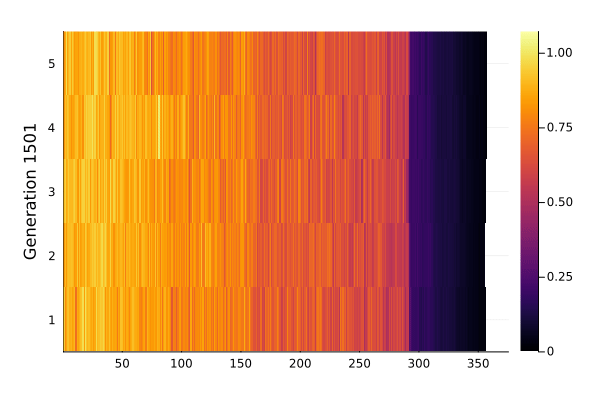

In [30]:
re_heatmap(repl(re["Aaneu"],1)/312,re["stats"]["n_gens"]-1000,re["stats"]["n_gens"]-950)

In [27]:
analyse(re) = av_by_dist((re["Aasel"]+re["Aaneu"])/1000,1555)

analyse (generic function with 1 method)

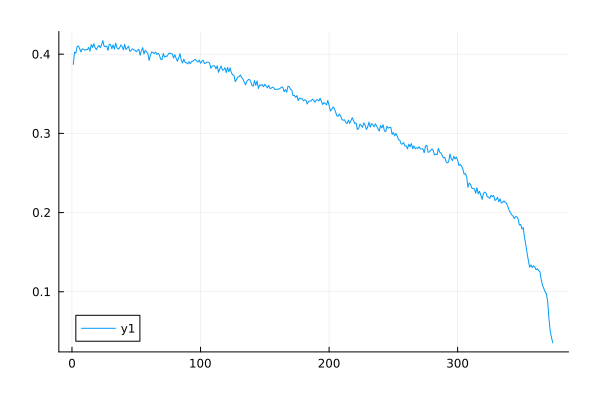

In [28]:
av_1 = analyse(re)
Plots.plot(analyse(re))

In [35]:
slope1, intercept1 = myfit(collect(1:340).*73, av_1[1:340])

(-8.119627295663589e-6, 0.4393235587235201)

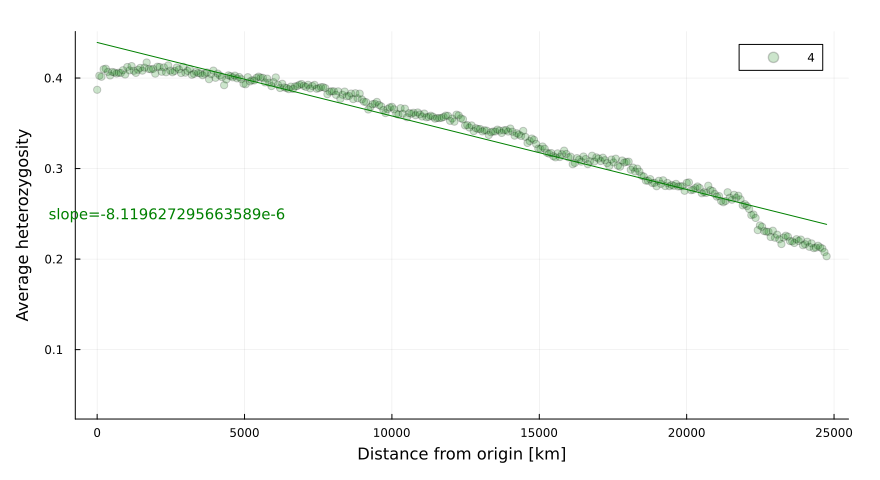

In [37]:
Plots.scatter(1:73:(73*340),av_1,label="4",color=:green,opacity=0.2,xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain,size=(880, 480))
Plots.plot!(1:73:(73*340),slope1.*collect(1:73:(73*340)).+intercept1,color=:green,label=:none)
Plots.annotate!(2365, 0.25, ("slope=$slope1", 10, :green))

---

In [3]:
re = deserialize("data/ooa_375_2.re")

Dict{String, Any} with 9 entries:
  "AAsel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "pops"  => Float32[]
  "aasel" => Float32[312.0 312.0 … 312.0 312.0; 312.0 312.0 … 312.0 312.0; … ; …
  "fitn"  => Float32[]
  "aaneu" => Float32[688.0 688.0 … 688.0 688.0; 688.0 688.0 … 688.0 688.0; … ; …
  "Aasel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "Aaneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "AAneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "stats" => Dict{String, Any}("n_sel_loci"=>312, "sel_loci"=>[307, 225, 953, 8…

┌ Info: Saved animation to C:\Users\Hartree\AppData\Local\Temp\jl_0hwXWrKryX.gif
└ @ Plots C:\Users\Hartree\.julia\packages\Plots\ju9dp\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\Hartree\\AppData\\Local\\Temp\\jl_0hwXWrKryX.gif")
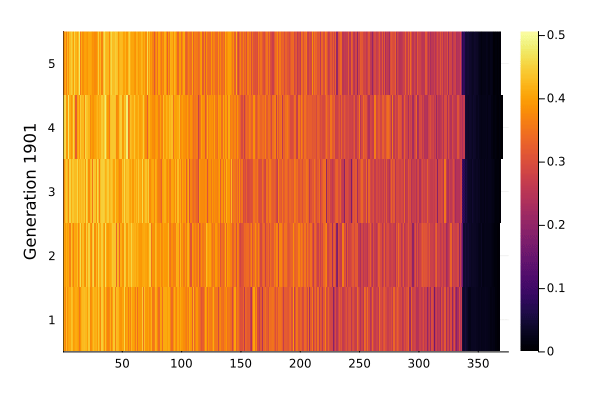

In [10]:
re_heatmap(repl(re["Aasel"],1)/312,re["stats"]["n_gens"]-600,re["stats"]["n_gens"]-550)

In [11]:
analyse(re) = av_by_dist((re["Aasel"]+re["Aaneu"])/1000,1940)

analyse (generic function with 1 method)

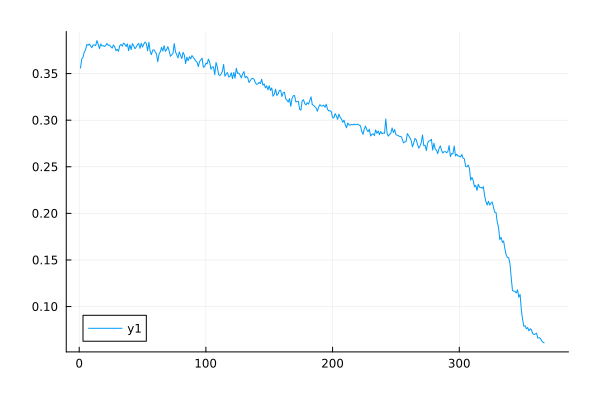

In [12]:
av_1 = analyse(re)
Plots.plot(analyse(re))

In [15]:
slope1, intercept1 = myfit(collect(15:304).*73, av_1[15:304])

(-6.411792968895514e-6, 0.40173900105659544)

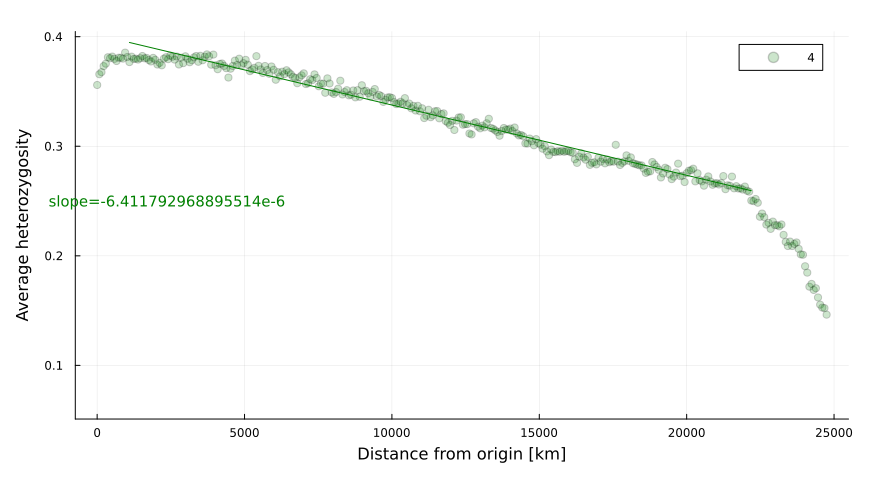

In [17]:
Plots.scatter(1:73:(73*340),av_1,label="4",color=:green,opacity=0.2,xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain,size=(880, 480))
Plots.plot!((15*73):73:(73*304),slope1.*collect((15*73):73:(73*304)).+intercept1,color=:green,label=:none)
Plots.annotate!(2365, 0.25, ("slope=$slope1", 10, :green))

---

In [4]:
re_hex = deserialize("data/ooa_move6.re")

Dict{String, Any} with 9 entries:
  "AAsel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "pops"  => Float32[]
  "aasel" => Float32[312.0 312.0 … 312.0 312.0; 312.0 312.0 … 312.0 312.0; … ; …
  "fitn"  => Float32[]
  "aaneu" => Float32[688.0 688.0 … 688.0 688.0; 688.0 688.0 … 688.0 688.0; … ; …
  "Aasel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "Aaneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "AAneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "stats" => Dict{String, Any}("n_sel_loci"=>312, "sel_loci"=>[78, 186, 985, 41…

┌ Info: Saved animation to C:\Users\Hartree\AppData\Local\Temp\jl_OPMFMjs1EJ.gif
└ @ Plots C:\Users\Hartree\.julia\packages\Plots\ju9dp\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\Hartree\\AppData\\Local\\Temp\\jl_OPMFMjs1EJ.gif")
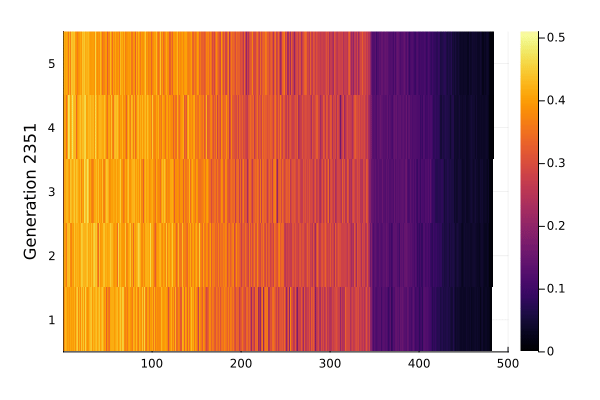

In [5]:
re_heatmap(repl(re_ort["Aasel"],1)/312,re_ort["stats"]["n_gens"]-150,re_ort["stats"]["n_gens"]-50)

In [6]:
analyse(re) = av_by_dist((re["Aasel"]+re["Aaneu"])/1000,2430)

analyse (generic function with 1 method)

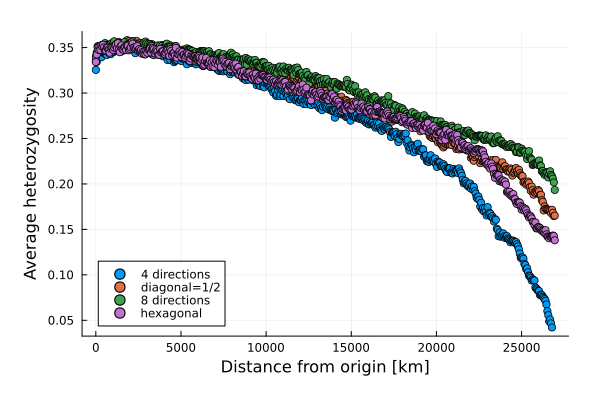

In [7]:

av_ort = analyse(re_ort)
av_half = analyse(re_half)
av_all = analyse(re_all)
av_hex = analyse(re_hex)
Plots.scatter(1:54:(500*54),av_ort,label="4 directions",xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain)
Plots.scatter!(1:54:(500*54),av_half,label="diagonal=1/2")
Plots.scatter!(1:54:(500*54),av_all,label="8 directions")
Plots.scatter!(1:54:(500*54),av_hex,label="hexagonal")

In [8]:
slope1, intercept1 = myfit(collect(1:490).*54, av_ort[1:490])
slope2, intercept2 = myfit(collect(1:490).*54, av_half[1:490])
slope3, intercept3 = myfit(collect(1:490).*54, av_all[1:490])
slope4, intercept4 = myfit(collect(1:490).*54, av_hex[1:490])

(-6.692160134126102e-6, 0.37668925486388427)

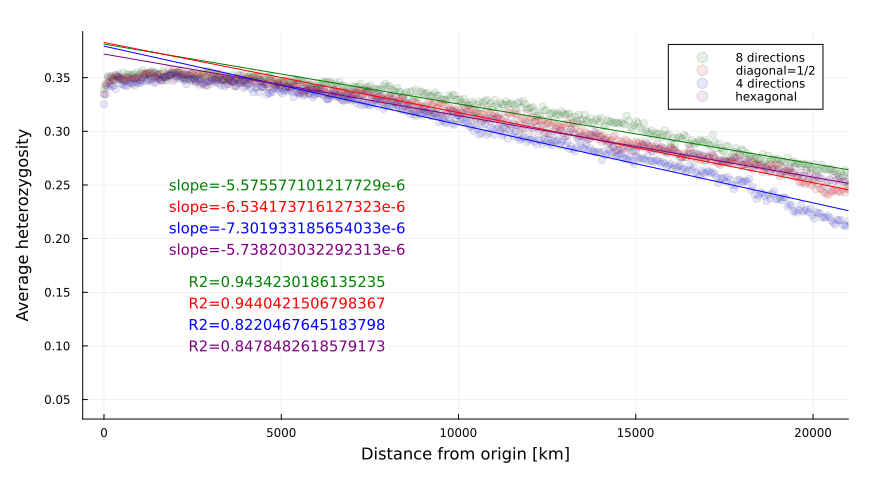

In [11]:
Plots.scatter(1:54:(500*54),av_all,label="8 directions",color=:green,opacity=0.1,xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain,size=(880, 480),xlim=(-600,21000))
Plots.scatter!(1:54:(500*54),av_half,label="diagonal=1/2",color=:red,opacity=0.1)
Plots.scatter!(1:54:(490*54),av_ort,label="4 directions",color=:blue,opacity=0.1)
Plots.scatter!(1:54:(490*54),av_hex,label="hexagonal",color=:purple,opacity=0.1)

Plots.plot!(1:54:(54*500),slope3.*collect(1:54:(54*500)).+intercept3,color=:green,label=:none)
Plots.plot!(1:54:(54*500),slope2.*collect(1:54:(54*500)).+intercept2,color=:red,label=:none)
Plots.plot!(1:54:(54*490),slope1.*collect(1:54:(54*490)).+intercept1,color=:blue,label=:none)
Plots.plot!(1:54:(54*490),slope4.*collect(1:54:(54*490)).+intercept4,color=:purple,label=:none)

Rtwo_all = Rtwo(av_all,slope3.*collect(1:54:(54*500)).+intercept3)
Rtwo_half = Rtwo(av_half,slope2.*collect(1:54:(54*500)).+intercept2)
Rtwo_ort = Rtwo(av_ort[1:490],slope1.*collect(1:54:(54*490)).+intercept1)
Rtwo_hex = Rtwo(av_hex,slope4.*collect(1:54:(54*500)).+intercept4)

Plots.annotate!(5165, 0.25, ("slope=$slope3", 10, :green))
Plots.annotate!(5165, 0.23, ("slope=$slope2", 10, :red))
Plots.annotate!(5165, 0.21, ("slope=$slope1", 10, :blue))
Plots.annotate!(5165, 0.19, ("slope=$slope4", 10, :purple))

Plots.annotate!(5165, 0.16, ("R2=$Rtwo_all", 10, :green))
Plots.annotate!(5165, 0.14, ("R2=$Rtwo_half", 10, :red))
Plots.annotate!(5165, 0.12, ("R2=$Rtwo_ort", 10, :blue))
Plots.annotate!(5165, 0.10, ("R2=$Rtwo_hex", 10, :purple))

In [10]:
slope3, intercept3 = myfit(collect(55:463).*54, av_all[55:463])
slope2, intercept2 = myfit(collect(55:461).*54, av_half[55:461])
slope1, intercept1 = myfit(collect(55:398).*54, av_ort[55:398])
slope4, intercept4 = myfit(collect(55:420).*54, av_hex[55:420])

Rtwo_all = Rtwo(av_all[55:463],slope3.*collect((55*54):54:(54*463)).+intercept3)
Rtwo_half = Rtwo(av_half[55:461],slope2.*collect((55*54):54:(54*461)).+intercept2)
Rtwo_ort = Rtwo(av_ort[55:398],slope1.*collect((55*54):54:(54*398)).+intercept1)
Rtwo_hex = Rtwo(av_hex[55:420],slope4.*collect((55*54):54:(54*420)).+intercept4)

0.9867636374261555

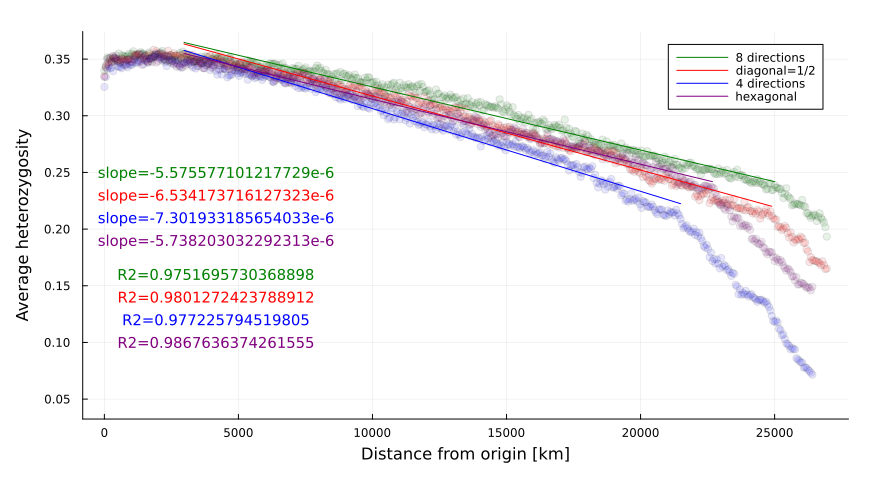

In [31]:
Plots.scatter(1:54:(500*54),av_all,label=:none,color=:green,opacity=0.1,xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain,size=(880, 480))
Plots.scatter!(1:54:(500*54),av_half,label=:none,color=:red,opacity=0.1)
Plots.scatter!(1:54:(490*54),av_ort,label=:none,color=:blue,opacity=0.1)
Plots.scatter!(1:54:(490*54),av_hex,label=:none,color=:purple,opacity=0.1)

Plots.plot!((55*54):54:(54*463),slope3.*collect((55*54):54:(54*463)).+intercept3,color=:green,label="8 directions")
Plots.plot!((55*54):54:(54*461),slope2.*collect((55*54):54:(54*461)).+intercept2,color=:red,label="diagonal=1/2")
Plots.plot!((55*54):54:(54*398),slope1.*collect((55*54):54:(54*398)).+intercept1,color=:blue,label="4 directions")
Plots.plot!((55*54):54:(54*420),slope4.*collect((55*54):54:(54*420)).+intercept4,color=:purple,label="hexagonal")

Plots.annotate!(4165, 0.25, ("slope=$slope3", 10, :green))
Plots.annotate!(4165, 0.23, ("slope=$slope2", 10, :red))
Plots.annotate!(4165, 0.21, ("slope=$slope1", 10, :blue))
Plots.annotate!(4165, 0.19, ("slope=$slope4", 10, :purple))

Plots.annotate!(4165, 0.16, ("R2=$Rtwo_all", 10, :green))
Plots.annotate!(4165, 0.14, ("R2=$Rtwo_half", 10, :red))
Plots.annotate!(4165, 0.12, ("R2=$Rtwo_ort", 10, :blue))
Plots.annotate!(4165, 0.10, ("R2=$Rtwo_hex", 10, :purple))

---

In [3]:
re_ort = deserialize("data/ooa_moveex.re")
re_half = deserialize("data/ooa_move2ex.re")
re_all = deserialize("data/ooa_move3ex.re")

Dict{String, Any} with 9 entries:
  "AAsel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "pops"  => Float32[]
  "aasel" => Float32[312.0 312.0 … 312.0 312.0; 312.0 312.0 … 312.0 312.0; … ; …
  "fitn"  => Float32[]
  "aaneu" => Float32[688.0 688.0 … 688.0 688.0; 688.0 688.0 … 688.0 688.0; … ; …
  "Aasel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "Aaneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "AAneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "stats" => Dict{String, Any}("n_sel_loci"=>312, "sel_loci"=>[312, 5, 113, 916…

In [4]:
re_hex = deserialize("data/ooa_move6ex.re")

Dict{String, Any} with 9 entries:
  "AAsel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "pops"  => Float32[]
  "aasel" => Float32[312.0 312.0 … 312.0 312.0; 312.0 312.0 … 312.0 312.0; … ; …
  "fitn"  => Float32[]
  "aaneu" => Float32[688.0 688.0 … 688.0 688.0; 688.0 688.0 … 688.0 688.0; … ; …
  "Aasel" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "Aaneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "AAneu" => Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; NaN NaN … NaN Na…
  "stats" => Dict{String, Any}("n_sel_loci"=>312, "sel_loci"=>[856, 509, 281, 9…

(0.0f0, 0.50961536f0)


┌ Info: Saved animation to C:\Users\Hartree\AppData\Local\Temp\jl_nSXiFS3iT2.gif
└ @ Plots C:\Users\Hartree\.julia\packages\Plots\ju9dp\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\Hartree\\AppData\\Local\\Temp\\jl_nSXiFS3iT2.gif")
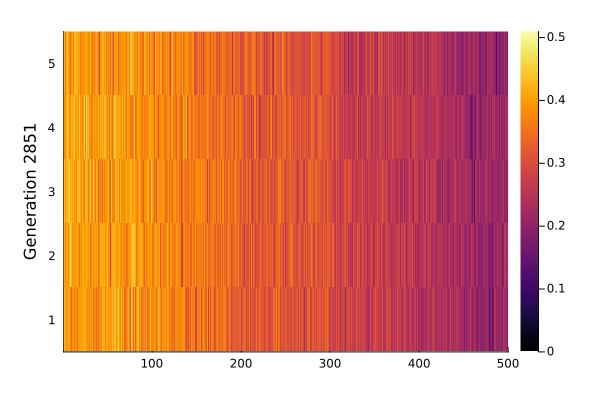

In [4]:
re_heatmap(repl(re_ort["Aasel"],1)/312,re_ort["stats"]["n_gens"]-150,re_ort["stats"]["n_gens"]-50)

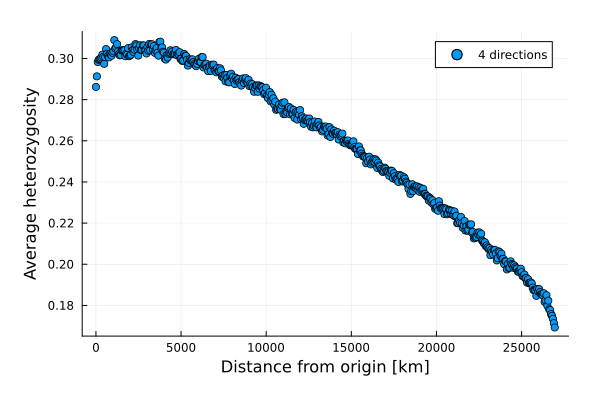

In [5]:
analyse(re) = av_by_dist((re["Aasel"]+re["Aaneu"])/1000,re["stats"]["n_gens"])
av_ort = analyse(re_ort)
Plots.scatter(1:54:(500*54),av_ort,label="4 directions",xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain)

┌ Info: Saved animation to C:\Users\Hartree\AppData\Local\Temp\jl_zMXi7qnWf6.gif
└ @ Plots C:\Users\Hartree\.julia\packages\Plots\ju9dp\src\animation.jl:156


Plots.AnimatedGif("C:\\Users\\Hartree\\AppData\\Local\\Temp\\jl_zMXi7qnWf6.gif")
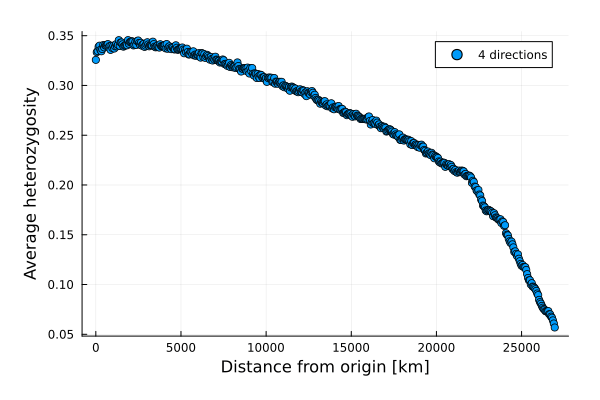

In [7]:
@gif for i in 2500:2:3000
    analyse(re) = av_by_dist((re["Aasel"]+re["Aaneu"])/1000,i)
    av_ort = analyse(re_ort)
    Plots.scatter(1:54:(500*54),av_ort,label="4 directions",xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain)
end

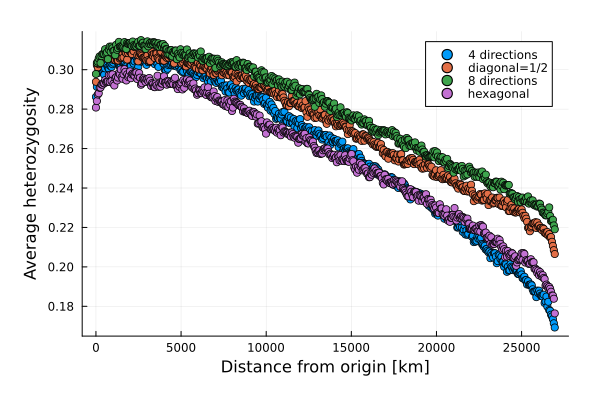

In [6]:
analyse(re) = av_by_dist((re["Aasel"]+re["Aaneu"])/1000,re["stats"]["n_gens"])

av_ort = analyse(re_ort)
av_half = analyse(re_half)
av_all = analyse(re_all)
av_hex = analyse(re_hex)
Plots.scatter(1:54:(500*54),av_ort,label="4 directions",xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain)
Plots.scatter!(1:54:(500*54),av_half,label="diagonal=1/2")
Plots.scatter!(1:54:(500*54),av_all,label="8 directions")
Plots.scatter!(1:54:(500*54),av_hex,label="hexagonal")

In [7]:
slope1, intercept1 = myfit(collect(1:490).*54, av_ort[1:490])
slope2, intercept2 = myfit(collect(1:490).*54, av_half[1:490])
slope3, intercept3 = myfit(collect(1:490).*54, av_all[1:490])
slope4, intercept4 = myfit(collect(1:490).*54, av_hex[1:490])

(-3.991126575787309e-6, 0.30976278319949274)

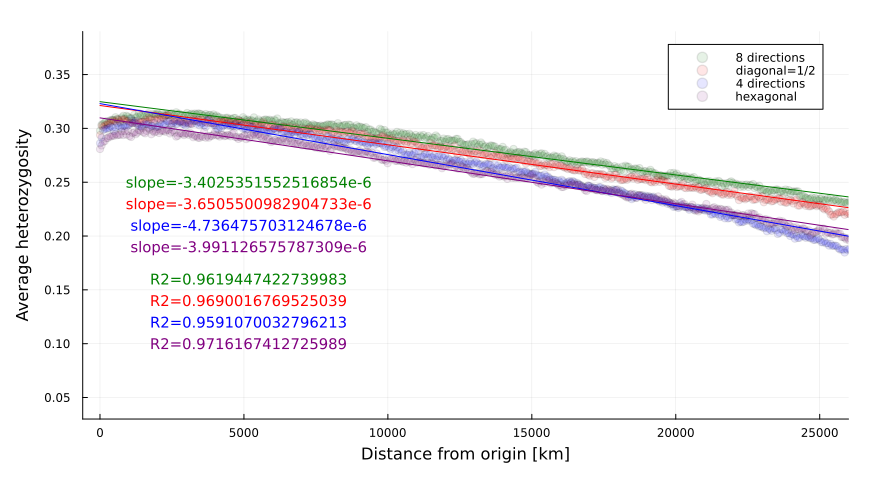

In [9]:
Plots.scatter(1:54:(500*54),av_all,label="8 directions",color=:green,opacity=0.1,xlabel="Distance from origin [km]",ylabel="Average heterozygosity",xformatter = :plain,size=(880, 480),xlim=(-600,26000),ylim=(0.03,0.39))
Plots.scatter!(1:54:(500*54),av_half,label="diagonal=1/2",color=:red,opacity=0.1)
Plots.scatter!(1:54:(500*54),av_ort,label="4 directions",color=:blue,opacity=0.1)
Plots.scatter!(1:54:(500*54),av_hex,label="hexagonal",color=:purple,opacity=0.1)

Plots.plot!(1:54:(54*490),slope3.*collect(1:54:(54*490)).+intercept3,color=:green,label=:none)
Plots.plot!(1:54:(54*490),slope2.*collect(1:54:(54*490)).+intercept2,color=:red,label=:none)
Plots.plot!(1:54:(54*490),slope1.*collect(1:54:(54*490)).+intercept1,color=:blue,label=:none)
Plots.plot!(1:54:(54*490),slope4.*collect(1:54:(54*490)).+intercept4,color=:purple,label=:none)

Rtwo_all = Rtwo(av_all[1:490],slope3.*collect(1:54:(54*490)).+intercept3)
Rtwo_half = Rtwo(av_half[1:490],slope2.*collect(1:54:(54*490)).+intercept2)
Rtwo_ort = Rtwo(av_ort[1:490],slope1.*collect(1:54:(54*490)).+intercept1)
Rtwo_hex = Rtwo(av_hex[1:490],slope4.*collect(1:54:(54*490)).+intercept4)

Plots.annotate!(5165, 0.25, ("slope=$slope3", 10, :green))
Plots.annotate!(5165, 0.23, ("slope=$slope2", 10, :red))
Plots.annotate!(5165, 0.21, ("slope=$slope1", 10, :blue))
Plots.annotate!(5165, 0.19, ("slope=$slope4", 10, :purple))

Plots.annotate!(5165, 0.16, ("R2=$Rtwo_all", 10, :green))
Plots.annotate!(5165, 0.14, ("R2=$Rtwo_half", 10, :red))
Plots.annotate!(5165, 0.12, ("R2=$Rtwo_ort", 10, :blue))
Plots.annotate!(5165, 0.10, ("R2=$Rtwo_hex", 10, :purple))